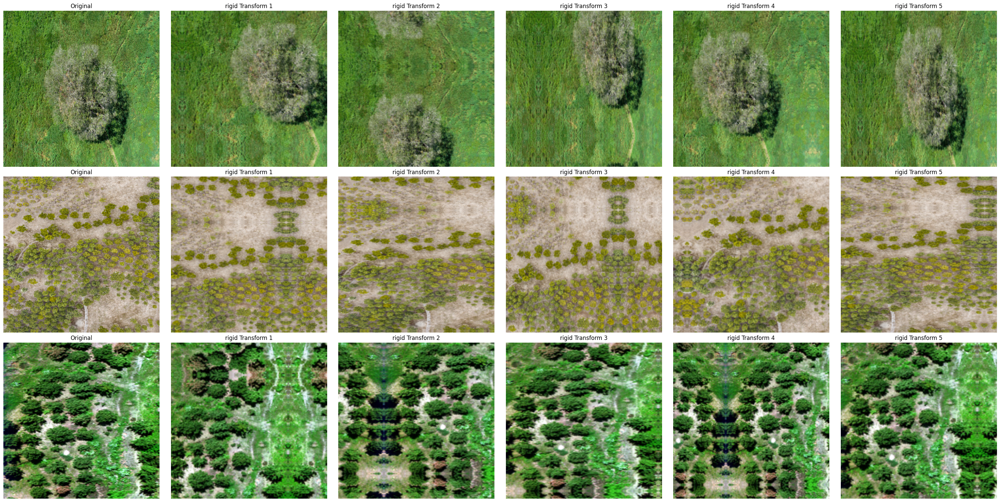

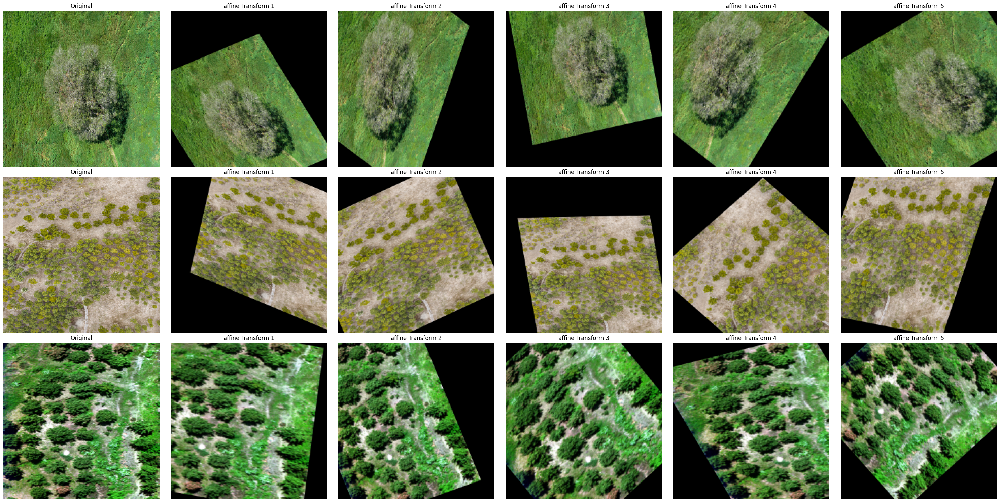

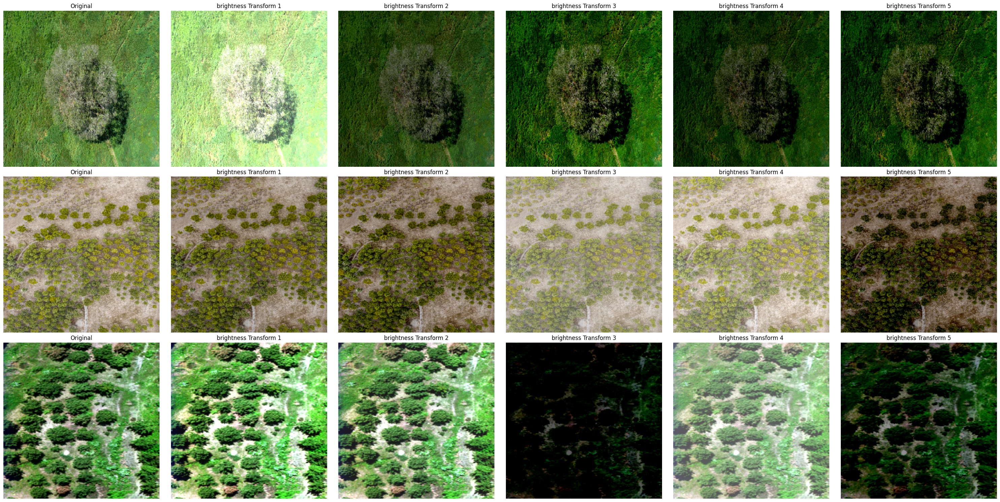

In [12]:
import cv2
import matplotlib.pyplot as plt
import albumentations as A
import torch
from torchvision import transforms
from torchvision.models import resnet50
from PIL import Image
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
import numpy as np

# 图像路径
image_paths = [
    "/workspace/sync/scripts/image_1.jpg",
    "/workspace/sync/scripts/image_2.jpg",
    "/workspace/sync/scripts/image_3.jpg"
]

# 读取和缩放图像
images = [cv2.imread(image_path) for image_path in image_paths]
images = [cv2.resize(img, (224, 224)) if img is not None else None for img in images]  # 确保所有图像被缩放

# 定义变换
transforms_list = {
    "rigid": A.ShiftScaleRotate(shift_limit=0.3, scale_limit=0.25, rotate_limit=0.3, p=1.0),
    "affine": A.Affine(scale=(0.8, 1.2), translate_percent=(-0.2, 0.2), rotate=(-45, 45), shear=(-10, 10), p=1.0),
    "brightness": A.RandomBrightnessContrast(brightness_limit=0.5, contrast_limit=0.3, p=1.0)
}

# 加载预训练的ResNet50模型
model = resnet50(pretrained=True)
model.eval()

# 定义目标层
target_layers = [model.layer4[-1]]

# 创建GradCAM对象
cam = GradCAM(model=model, target_layers=target_layers)

# 图像预处理转换
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# 应用变换并可视化
for key, transform in transforms_list.items():
    fig, axs = plt.subplots(len(images), 6, figsize=(30, 15))  # 每种变换6张图

    for i, img in enumerate(images):
        axs[i, 0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # 原图
        axs[i, 0].axis('off')
        axs[i, 0].set_title("Original")

        for j in range(1, 6):
            transformed_img = transform(image=img)['image']
            axs[i, j].imshow(cv2.cvtColor(transformed_img, cv2.COLOR_BGR2RGB))
            axs[i, j].axis('off')
            axs[i, j].set_title(f"{key} Transform {j}")

    plt.tight_layout()
    plt.show()


/root/miniconda3/envs/pytorch_base/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/envs/pytorch_base/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


grads_list: [array([[[[-0.00020279, -0.00020279, -0.00020279, ..., -0.00020279,
          -0.00020279, -0.00020279],
         [-0.00020279, -0.00020279, -0.00020279, ..., -0.00020279,
          -0.00020279, -0.00020279],
         [-0.00020279, -0.00020279, -0.00020279, ..., -0.00020279,
          -0.00020279, -0.00020279],
         ...,
         [-0.00020279, -0.00020279, -0.00020279, ..., -0.00020279,
          -0.00020279, -0.00020279],
         [-0.00020279, -0.00020279, -0.00020279, ..., -0.00020279,
          -0.00020279, -0.00020279],
         [-0.00020279, -0.00020279, -0.00020279, ..., -0.00020279,
          -0.00020279, -0.00020279]],

        [[-0.00089779, -0.00089779, -0.00089779, ..., -0.00089779,
          -0.00089779, -0.00089779],
         [-0.00089779, -0.00089779, -0.00089779, ..., -0.00089779,
          -0.00089779, -0.00089779],
         [-0.00089779, -0.00089779, -0.00089779, ..., -0.00089779,
          -0.00089779, -0.00089779],
         ...,
         [-0.00089779

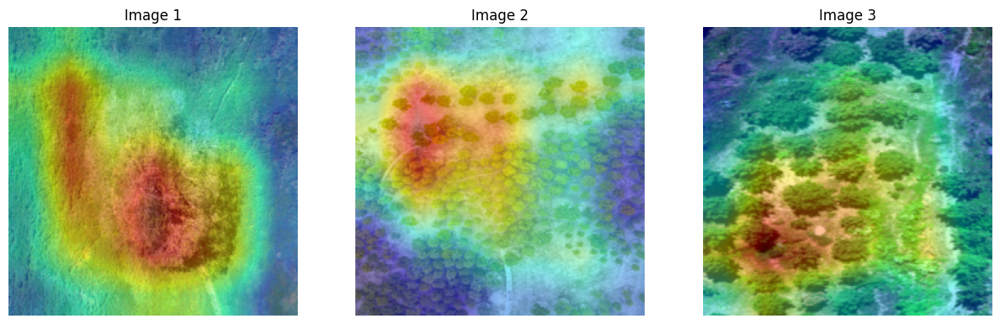

In [3]:
import torch
from torchvision import transforms
from torchvision.models import resnet18
from PIL import Image
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import matplotlib.pyplot as plt
import numpy as np

# 加载预训练的ResNet50模型
model = resnet18(pretrained=True)
model.eval()

# 定义目标层
target_layers = [model.layer4[-1]]

# 创建GradCAM对象
cam = GradCAM(model=model, target_layers=target_layers)

# 图像预处理转换
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
vis_transform = transforms.Compose([
    transforms.Resize((224, 224)),
])

# 加载和预处理图片
image_paths = [
    "/workspace/sync/SSL-Backdoor/scripts/image_1.jpg",
    "/workspace/sync/SSL-Backdoor/scripts/image_2.jpg",
    "/workspace/sync/SSL-Backdoor/scripts/image_3.jpg"
]

# 展示结果
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, img_path in enumerate(image_paths):
    img = Image.open(img_path).convert('RGB')
    input_tensor = preprocess(img)
    input_tensor_batch = input_tensor.unsqueeze(0)  # 创建单个图片的batch

    # 定义类激活图目标类别，这里以ImageNet中的某个类别为例
    # targets = [ClassifierOutputTarget(281)]  # 修改此处以匹配目标类别

    # 生成类激活图
    grayscale_cams = cam(input_tensor=input_tensor_batch)

    # 读取图片用于展示
    rgb_img = vis_transform(img)
    # rgb_img = img
    rgb_img = np.array(rgb_img) / 255.0
    grayscale_cam = grayscale_cams[0, :]  # 获取单个图像的CAM
    visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True, image_weight=0.6)
    axes[i].imshow(visualization)
    axes[i].axis('off')
    axes[i].set_title(f"Image {i+1}")

plt.show()

In [ ]:
import torch
from torchvision import transforms
from torchvision.models import resnet50
from PIL import Image
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import matplotlib.pyplot as plt
import numpy as np

# 加载预训练的ResNet50模型
model = resnet50(pretrained=True)
model.eval()

# 定义目标层
target_layers = [model.layer4[-1]]

# 创建GradCAM对象
cam = GradCAM(model=model, target_layers=target_layers)

# 图像预处理转换
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
vis_transform = transforms.Compose([
    transforms.Resize((224, 224)),
])

# 加载和预处理图片
image_paths = [
    "/workspace/sync/cam_image_1.jpg",
    "/workspace/sync/cam_image_2.jpg",
    "/workspace/sync/cam_image_3.jpg"
]

# 展示结果
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, img_path in enumerate(image_paths):
    img = Image.open(img_path).convert('RGB')
    input_tensor = preprocess(img)
    input_tensor_batch = input_tensor.unsqueeze(0)  # 创建单个图片的batch

    # 定义类激活图目标类别，这里以ImageNet中的某个类别为例
    # targets = [ClassifierOutputTarget(281)]  # 修改此处以匹配目标类别

    # 生成类激活图
    grayscale_cams = cam(input_tensor=input_tensor_batch)

    # 读取图片用于展示
    rgb_img = vis_transform(img)
    # rgb_img = img
    rgb_img = np.array(rgb_img) / 255.0
    grayscale_cam = grayscale_cams[0, :]  # 获取单个图像的CAM
    visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True, image_weight=0.6)
    axes[i].imshow(visualization)
    axes[i].axis('off')
    axes[i].set_title(f"Image {i+1}")

plt.show()